In [1]:
!pip install keras-retinanet
!pip install pydicom

In [2]:
%cd /content/drive/MyDrive/keras-retinanet-trained-algorithm

[Errno 2] No such file or directory: '/content/drive/MyDrive/keras-retinanet-trained-algorithm'
/Users/matthewthanos/EdenSehatAI/breast-cancer


Output Image:


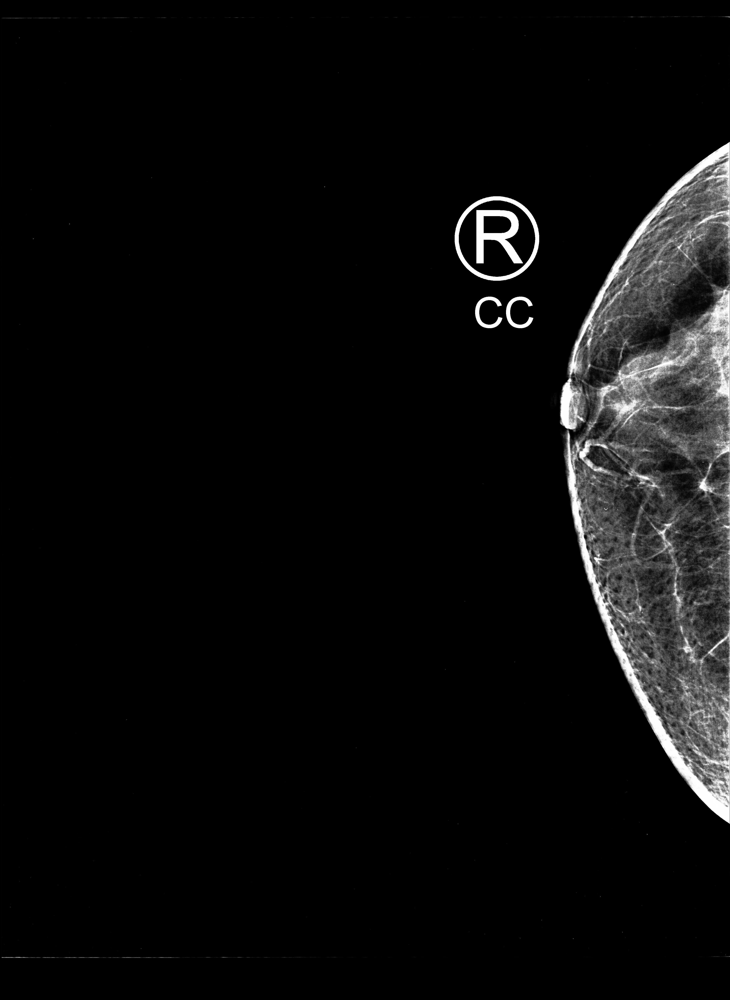

Output Image:


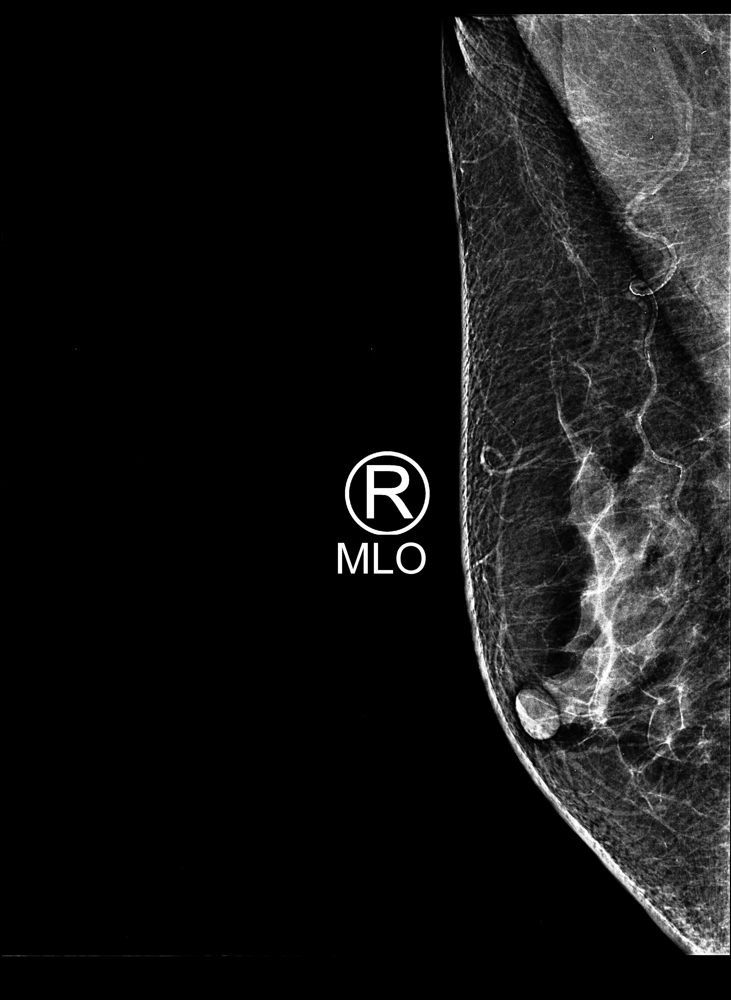

Output Image:


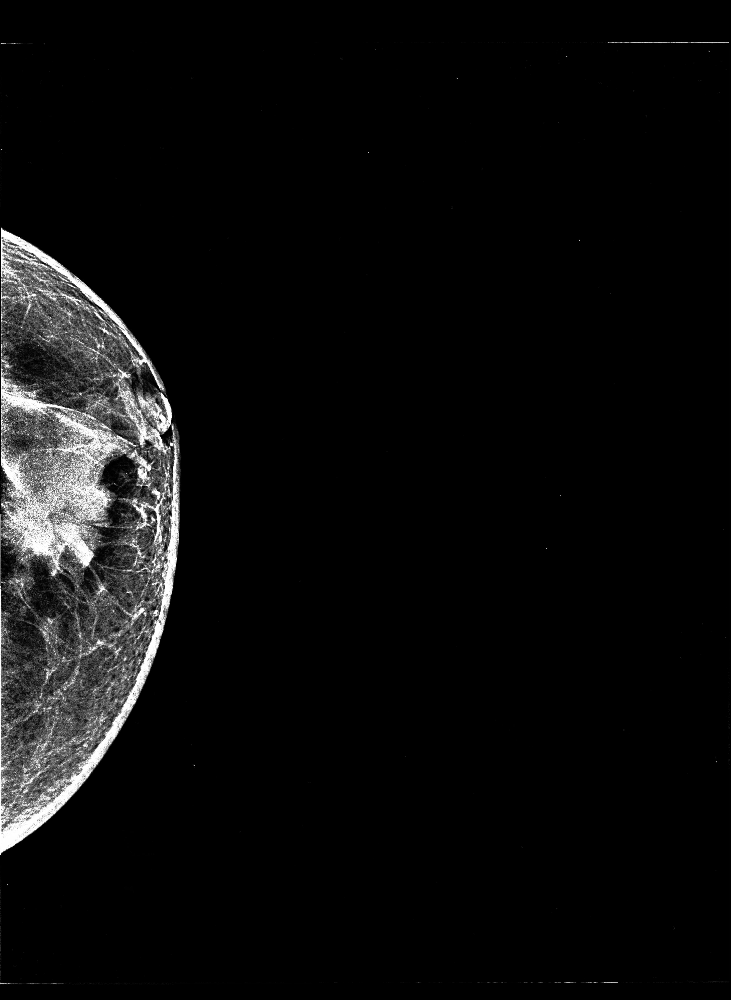

Output Image:


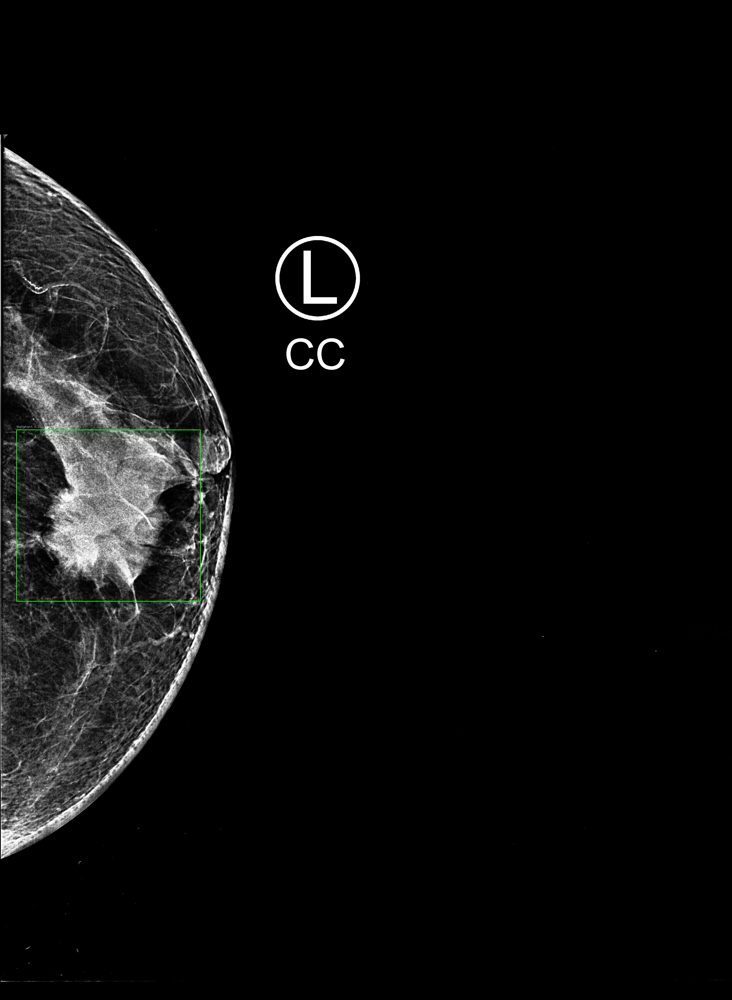

Output Image:


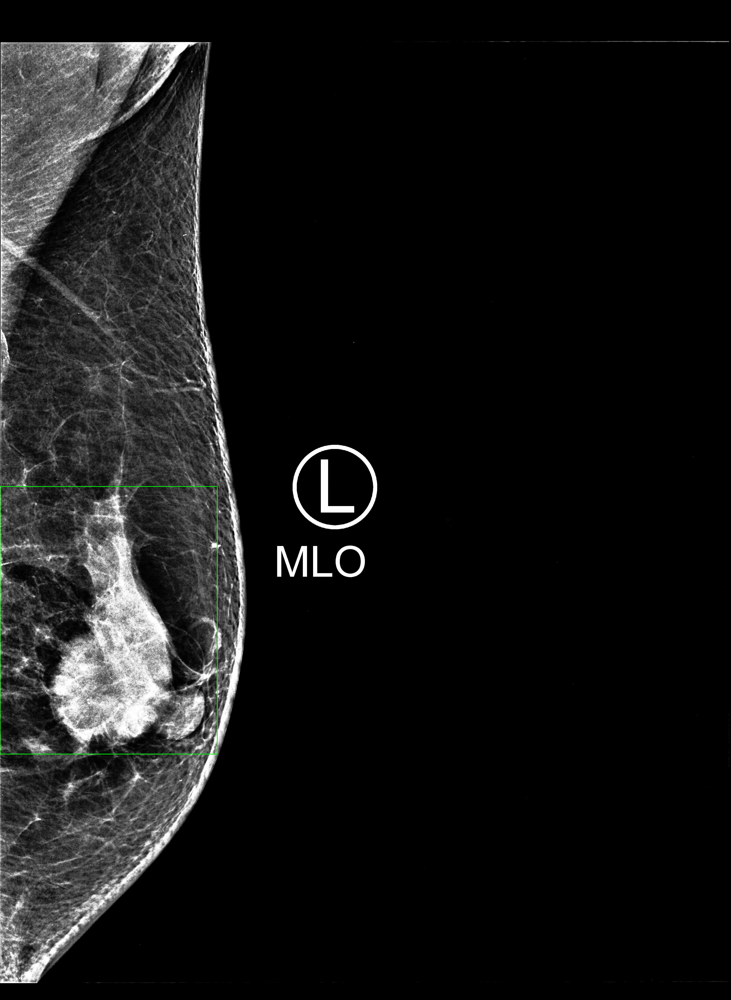

In [3]:
import keras
import cv2
import os
import glob
import numpy as np
import pydicom
from PIL import Image
import tempfile
import shutil
import tensorflow.compat.v1 as tf
from keras_retinanet import models
from keras_retinanet.utils.image import preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from IPython.display import display

def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    return tf.Session(config=config)

def dicom_to_rgb(dicom_path, output_path):
    ds = pydicom.dcmread(dicom_path)
    img = ds.pixel_array
    img = (img / img.max() * 255).astype('uint8')
    img_rgb = Image.fromarray(img, 'L').convert('RGB')
    img_rgb.save(output_path)

def create_temp_dir():
    return tempfile.mkdtemp()

def convert_dicom_to_rgb_and_save(dicom_path, temp_dir):
    for dicom_path in glob.glob(dicom_path):
        output_file = os.path.join(temp_dir, os.path.basename(dicom_path).replace('.dcm', '.jpg'))
        dicom_to_rgb(dicom_path, output_file)
    return output_file

images_path = './testimages/*'
rspik_path = './rspikimages/*'
roi_path = './testroi/*'
cropped_path = './testcropped/*'
output_dir = './inference/'
score_threshold = 0.3
model_path = './resnet152_pascal.h5'

model = models.load_model(model_path, backbone_name='resnet152')
model = models.convert_model(model)

labels_to_names = {11: 'Malignant'}

def process_and_display_images(img_paths, output_dir, model, score_threshold=0.3):
    for imgpath in img_paths:
        output_file = os.path.join(output_dir, os.path.basename(imgpath))
        if imgpath.lower().endswith('.dcm'):
            pass
        else:
            image = cv2.imread(imgpath)[...,::-1]
            draw = image.copy()
            image = preprocess_image(image)
            image, scale = resize_image(image)
            boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
            boxes /= scale
            for box, score, label in zip(boxes[0], scores[0], labels[0]):
                if score < score_threshold:
                    break
                color = label_color(label)
                b = box.astype(int)
                draw_box(draw, b, color=color)
                caption = "{} {:.3f}".format(labels_to_names[label], score)
                draw_caption(draw, b, caption)
            Image.fromarray(np.uint8(draw)).save(output_file)
            print("Output Image:")
            display(Image.open(output_file))

def cleanup_temp_dir(temp_dir):
    shutil.rmtree(temp_dir)

temp_dir = create_temp_dir()
dicom_output_file = convert_dicom_to_rgb_and_save(rspik_path, temp_dir)
img_paths = glob.glob(os.path.join(temp_dir, '*.jpg'))
process_and_display_images(img_paths, output_dir, model, score_threshold)
cleanup_temp_dir(temp_dir)


In [ ]:
# from collections import defaultdict

# # Collect images based on their prefixes
# image_collections = defaultdict(list)

# for imgpath in sorted(glob.glob(images_path)):
#     print(imgpath)

#     # Extract prefix from the filename
#     filename = os.path.basename(imgpath)
#     prefix = os.path.splitext(filename)[0].rsplit('_', 1)[0]

#     # Generate the output file path
#     output_file = os.path.join(output_dir, filename.replace('.dcm', '.jpg'))

#     # Check if the image is a DICOM file
#     if imgpath.lower().endswith('.dcm'):
#         dicom_to_rgb(imgpath, output_file)
#     else:
#         # Read image in BGR and convert to RGB
#         image = cv2.imread(imgpath)[...,::-1]

#         # Copy to draw on
#         draw = image.copy()

#         # Preprocess image for network
#         image = preprocess_image(image)
#         image, scale = resize_image(image)

#         # Process image
#         boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))

#         # Correct for image scale
#         boxes /= scale

#         # Visualize detections
#         for box, score, label in zip(boxes[0], scores[0], labels[0]):
#             if score < score_threshold:
#                 break

#             color = label_color(label)
#             b = box.astype(int)
#             draw_box(draw, b, color=color)
#             caption = "{} {:.3f}".format(labels_to_names[label], score)
#             draw_caption(draw, b, caption)

#         # Save the output image
#         Image.fromarray(np.uint8(draw)).save(output_file)

#     # Read and display the converted image
#     img_input = Image.open(imgpath)

#     # Display the input image
#     # print("Input Image:")
#     # display(img_input)

#     # Display the output image
#     img_output = Image.open(output_file)
#     # print("Output Image:")
#     # display(img_output)

#     # Display the ROI image
#     roi_file = os.path.join('./testroi/', filename)
#     img_roi = Image.open(roi_file) if os.path.exists(roi_file) else Image.new('RGB', img_input.size, (255, 255, 255))
#     # print("ROI Image:")
#     # display(img_roi)

#     # Combine images into a 1x3 grid with white background and filename
#     combined_width = img_input.width * 3 + 20  # 20 is the gap between images
#     combined_height = img_input.height + 80  # 80 is for the larger filename text

#     combined_image = Image.new('RGB', (combined_width, combined_height), 'white')

#     # Paste images with a small gap
#     combined_image.paste(img_input, (0, 0))
#     combined_image.paste(img_roi, (img_input.width + 10, 0))  # Add a small gap
#     combined_image.paste(img_output, (2 * img_input.width + 20, 0))  # Add a small gap

#     # Add filename to the combined image with a larger font size
#     draw = ImageDraw.Draw(combined_image)
#     #draw.text((10, img_input.height + 20), filename, fill='black', font=font)

#     # Store images in the collection based on prefix
#     image_collections[prefix].append(combined_image)

# # Display the combined images in a 2x3 grid for images with the same prefix
# for prefix, images in image_collections.items():
#     combined_grid = Image.new('RGB', (combined_width, combined_height * len(images)), 'white')

#     for idx, img in enumerate(images):
#         combined_grid.paste(img, (0, idx * combined_height))

#     print(f"Combined Image Grid for Prefix: {prefix}")
#     display(combined_grid)
